# **Introduction**

In this notebook, I analyze real estate data and build the machine learning model which runs on the backend of my House Price Prediction API.

My data came from a [competition on Kaggle](https://www.kaggle.com/c/zillow-prize-1) in which Zillow released a large amount of real estate data from within and around the Los Angeles area (though it lacked many features which could have been very useful and was very unclean initially).

This notebook can be divided into three main sections; the zeroth section was finding good real estate data.  Unfortunately, almost all real estate data is closely guarded by the National Association of Realtors.  It was incredibly difficult to find good real estate data for this project, but I think I ultimately really lucked out with Zillow's data, and in my decision to predict tax assesed value.  I explain this decision below.  The first section is data cleaning (the raw dataset from Kaggle was surprisingly dirty and full of gaps).  The second section is EDA (in which I explore the data visually and through the use of statistics to exctract lots of useful and interesting insights).  Finally, the third section was development of predictive price models.  I ultimately build a linear regression (first applying hot encoding and PCA to embed categorical data), a decision tree, a random forest, and a CatBoost model (a gradient-boosted tree model).

# **Package installs, imports**

In [0]:
%%capture
!pip install pandasql
!pip install gmaps
!pip install ipywidgets
!pip install widgetsnbextension
!pip install dython
!pip install scikit-learn
!pip install prince
!pip install catboost

In [0]:
%%capture
import pandas as pd 
import csv
import random
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import cm
from datetime import datetime
import glob
import seaborn as sns
import gmaps
import IPython
from IPython.display import display, HTML
from ipywidgets.embed import embed_minimal_html
import numpy as np
import math
from dython import nominal
import sklearn
import prince



from pandasql import sqldf

def pysqldf(q):
 return sqldf(q, globals())

# **Data import**

We will be using house price data taken from Kaggle's Zestimate competition (https://www.kaggle.com/c/zillow-prize-1).  Unfortunately, due to legal reasons, Zillow cannot release the actual price data for the homes in their dataset, so they instead released the error between their estimate and the actual price.  In fact, it is impossible to get one's hands on a large amount of house features / price data because the National Association of Realtors has monopoly control over multiple listing service (MLS) data, and you have to be a realtor to gain access to it.  I did not want to make a model predicting the error on Zillow's model, because there would be fewer meaningful trends in that data (bad for EDA), and most of the error in Zillow's model is probably due to random noise.  However, the Zillow data does include three fields which save the day: the tax assesed value of the property, the tax assesed value of the house, and the total tax assesed value of the real estate parcel.  Since the price at which a home is sold is simply determined by a few people agreeing on a fair value, it seems the tax assesed value (which is just the fair value of the proprty estimated by a tax assesor) is a good proxy for the sale price.  All of the same elements of human subjectivity and preferences will be baked into that data as would be in the actual price data.  So that label will suffice for this project (serving as a proxy for price).

In [3]:
from google.colab import drive 
drive.mount('/content/gdrive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


Here we import the metadata (useful later for determining what certain column names or category codes mean).

In [0]:
dictionaries = {}
reader = csv.reader(open('/content/gdrive/My Drive/Colab Notebooks/CIS192_Final_Project/Data/zillow-prize-1/dict/DataDictionary.csv', 'r', encoding='cp1252'))
dictionaries['DataDictionary'] = {}
for row in reader:
   k, v = row
   dictionaries['DataDictionary'][k.replace("'", "").lower()] = v

In [0]:
for filename in ['HeatingOrSystemTypeID', 'PropertyLandUseTypeID', 'StoryTypeID', 
                 'AirConditioningTypeID', 'ArchitecturalStyleTypeID', 
                 'TypeConstructionTypeID', 'BuildingClassTypeID']:
  reader = csv.reader(open('/content/gdrive/My Drive/Colab Notebooks/CIS192_Final_Project/Data/zillow-prize-1/dict/'+filename+'.csv', 'r', encoding='cp1252'))
  dictionaries[filename.lower()] = {}
  for row in reader:
    k, v = row
    if not 'ID' in k:
      dictionaries[filename.lower()][int(k)] = v


In [0]:
columns_with_dict = [w.lower() for w in ['HeatingOrSystemTypeID', 'PropertyLandUseTypeID', 'StoryTypeID', 
                 'AirConditioningTypeID', 'ArchitecturalStyleTypeID', 
                 'TypeConstructionTypeID', 'BuildingClassTypeID']]

Here we define the dataframe schema.  Note that we have to use floats because of the existence of NaN values.  We will clean the data and then recast the appropriate columns as ints later.

In [0]:
properties_dtypes = {'parcelid': int, 'airconditioningtypeid': float, 'architecturalstyletypeid': float,
       'basementsqft': float, 'bathroomcnt': float, 'bedroomcnt': float, 'buildingclasstypeid': float,
       'buildingqualitytypeid': float, 'calculatedbathnbr': float, 'decktypeid': float,
       'finishedfloor1squarefeet': float, 'calculatedfinishedsquarefeet': float,
       'finishedsquarefeet12': float, 'finishedsquarefeet13': float, 'finishedsquarefeet15': float,
       'finishedsquarefeet50': float, 'finishedsquarefeet6': float, 'fips': float, 'fireplacecnt': float,
       'fullbathcnt': float, 'garagecarcnt': float, 'garagetotalsqft': float, 'hashottuborspa': float,
       'heatingorsystemtypeid': float, 'latitude': float, 'longitude': float, 'lotsizesquarefeet': float,
       'poolcnt': float, 'poolsizesum': float, 'pooltypeid10': float, 'pooltypeid2': float, 'pooltypeid7': float,
       'propertycountylandusecode': str, 'propertylandusetypeid': float,
       'propertyzoningdesc': str, 'rawcensustractandblock': float, 'regionidcity': float,
       'regionidcounty': float, 'regionidneighborhood': float, 'regionidzip': float, 'roomcnt': float,
       'storytypeid': float, 'threequarterbathnbr': float, 'typeconstructiontypeid': float,
       'unitcnt': float, 'yardbuildingsqft17': float, 'yardbuildingsqft26': float, 'yearbuilt': float,
       'numberofstories': float, 'fireplaceflag': float, 'structuretaxvaluedollarcnt': float,
       'taxvaluedollarcnt': float, 'assessmentyear': float, 'landtaxvaluedollarcnt': float,
       'taxamount': float, 'taxdelinquencyflag': str, 'taxdelinquencyyear': float,
       'censustractandblock': float}

Here we import the main data we will be using for this project.

In [8]:
properties_2016_df = pd.read_csv('/content/gdrive/My Drive/Colab Notebooks/CIS192_Final_Project/Data/zillow-prize-1/properties_2016.csv',
                               header=0, dtype=properties_dtypes)
properties_2016_df.shape

(2985217, 58)

In [9]:
properties_2017_df = pd.read_csv('/content/gdrive/My Drive/Colab Notebooks/CIS192_Final_Project/Data/zillow-prize-1/properties_2017.csv',
                               header=0, dtype=properties_dtypes)
properties_2017_df.shape

(2985217, 58)

In [10]:
properties_df = properties_2016_df.append(properties_2017_df)
properties_df

,parcelid,airconditioningtypeid,architecturalstyletypeid,basementsqft,bathroomcnt,bedroomcnt,buildingclasstypeid,buildingqualitytypeid,calculatedbathnbr,decktypeid,finishedfloor1squarefeet,calculatedfinishedsquarefeet,finishedsquarefeet12,finishedsquarefeet13,finishedsquarefeet15,finishedsquarefeet50,finishedsquarefeet6,fips,fireplacecnt,fullbathcnt,garagecarcnt,garagetotalsqft,hashottuborspa,heatingorsystemtypeid,latitude,longitude,lotsizesquarefeet,poolcnt,poolsizesum,pooltypeid10,pooltypeid2,pooltypeid7,propertycountylandusecode,propertylandusetypeid,propertyzoningdesc,rawcensustractandblock,regionidcity,regionidcounty,regionidneighborhood,regionidzip,roomcnt,storytypeid,threequarterbathnbr,typeconstructiontypeid,unitcnt,yardbuildingsqft17,yardbuildingsqft26,yearbuilt,numberofstories,fireplaceflag,structuretaxvaluedollarcnt,taxvaluedollarcnt,assessmentyear,landtaxvaluedollarcnt,taxamount,taxdelinquencyflag,taxdelinquencyyear,censustractandblock
0,10754147,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,1.0,NaN,34144442.0,-118654084.0,85768.0,NaN,NaN,NaN,NaN,NaN,010D,269.0,NaN,6.037800e+07,37688.0,3101.0,NaN,96337.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,9.0,2015.0,9.0,NaN,NaN,NaN,NaN
1,10759547,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,1.0,NaN,34140430.0,-118625364.0,4083.0,NaN,NaN,NaN,NaN,NaN,0109,261.0,LCA11*,6.037800e+07,37688.0,3101.0,NaN,96337.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,27516.0,2015.0,27516.0,NaN,NaN,NaN,NaN
2,10843547,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,73026.0,NaN,NaN,73026.0,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,1.0,NaN,33989359.0,-118394633.0,63085.0,NaN,NaN,NaN,NaN,NaN,1200,47.0,LAC2,6.037703e+07,51617.0,3101.0,NaN,96095.0,0.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,1.0,650756.0,1413387.0,2015.0,762631.0,20800.37,NaN,NaN,NaN
3,10859147,NaN,NaN,NaN,0.0,0.0,3.0,7.0,NaN,NaN,NaN,5068.0,NaN,NaN,5068.0,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,1.0,NaN,34148863.0,-118437206.0,7521.0,NaN,NaN,NaN,NaN,NaN,1200,47.0,LAC2,6.037141e+07,12447.0,3101.0,27080.0,96424.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,1948.0,1.0,1.0,571346.0,1156834.0,2015.0,585488.0,14557.57,NaN,NaN,NaN
4,10879947,NaN,NaN,NaN,0.0,0.0,4.0,NaN,NaN,NaN,NaN,1776.0,NaN,NaN,1776.0,NaN,NaN,6037.0,NaN,NaN,NaN,NaN,1.0,NaN,34194168.0,-118385816.0,8512.0,NaN,NaN,NaN,NaN,NaN,1210,31.0,LAM1,6.037123e+07,12447.0,3101.0,46795.0,96450.0,0.0,NaN,NaN,NaN,1.0,NaN,NaN,1947.0,NaN,1.0,193796.0,433491.0,2015.0,239695.0,5725.17,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2985212,12170430,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2985213,11422430,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2985214,17203030,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2985215,14242830,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# **Data cleaning**

To determine how to deal with NaN values, let's first determine the percentage of readings which are NaN in each column.

In [11]:
s = properties_df.isna().sum().sort_values() / properties_df.shape[0]
columns_percentage_null = pd.DataFrame({'Column_Name':s.index, 
                                        'Percentage_NaN':[("{:.3f}".format(r*100)) + "%" for r in s.values], 
                                        'Description': [dictionaries['DataDictionary'][r] for r in s.index]})
pd.set_option('display.max_colwidth', None)
columns_percentage_null

,Column_Name,Percentage_NaN,Description
0,parcelid,0.000%,Unique identifier for parcels (lots)
1,hashottuborspa,0.056%,Does the home have a hot tub or spa
2,fireplaceflag,0.112%,Is a fireplace present in this home
3,longitude,0.241%,Longitude of the middle of the parcel multiplied by 10e6
4,latitude,0.241%,Latitude of the middle of the parcel multiplied by 10e6
5,regionidcounty,0.241%,County in which the property is located
6,fips,0.241%,Federal Information Processing Standard code - see https://en.wikipedia.org/wiki/FIPS_county_code for more details
7,rawcensustractandblock,0.241%,Census tract and block ID combined - also contains blockgroup assignment by extension
8,propertylandusetypeid,0.241%,Type of land use the property is zoned for
9,assessmentyear,0.241%,The year of the property tax assessment


In [0]:
pd.set_option('display.max_colwidth', 50)

Let's fill in missing data where we can (using sensible defaults), drop columns which are not useful and/or have lots of missing data, and then drop all remaining rows with missing values.

In [0]:
properties_df[['hashottuborspa']] = properties_df[['hashottuborspa']].fillna(0)
properties_df[['fireplaceflag']] = properties_df[['fireplaceflag']].fillna(0)
properties_df['longitude'] /= 1000000
dictionaries['DataDictionary']['longitude'] = 'Longitude of the middle of the parcel'
properties_df['latitude'] /= 1000000
dictionaries['DataDictionary']['latitude'] = 'Latitude of the middle of the parcel'
properties_df[['heatingorsystemtypeid']] = properties_df[['heatingorsystemtypeid']].fillna(0)
dictionaries['heatingorsystemtypeid'][0] = 'None'
properties_df[['garagecarcnt']] = properties_df[['garagecarcnt']].fillna(0)
properties_df[['garagetotalsqft']] = properties_df[['garagetotalsqft']].fillna(0)
properties_df[['airconditioningtypeid']] = properties_df[['airconditioningtypeid']].fillna(0)
dictionaries['airconditioningtypeid'][0] = 'None'
properties_df[['numberofstories']] = properties_df[['numberofstories']].fillna(1)
properties_df[['poolcnt']] = properties_df[['poolcnt']].fillna(0)
properties_df[['fireplacecnt']] = properties_df[['fireplacecnt']].fillna(0)
properties_df[['threequarterbathnbr']] = properties_df[['threequarterbathnbr']].fillna(0)
properties_df.drop(columns=['finishedsquarefeet12', 'lotsizesquarefeet', 'propertyzoningdesc', 'unitcnt', 'buildingqualitytypeid',
       'regionidneighborhood', 'pooltypeid7', 'finishedsquarefeet50',
       'finishedfloor1squarefeet', 'finishedsquarefeet15',
       'yardbuildingsqft17', 'taxdelinquencyyear', 'taxdelinquencyflag',
       'pooltypeid2', 'poolsizesum', 'pooltypeid10', 'finishedsquarefeet6',
       'decktypeid', 'buildingclasstypeid', 'finishedsquarefeet13',
       'typeconstructiontypeid', 'architecturalstyletypeid',
       'yardbuildingsqft26', 'basementsqft', 'storytypeid', 'rawcensustractandblock', 
       'censustractandblock', 'taxamount', 'regionidcounty', 'calculatedbathnbr',
       'propertycountylandusecode', 'fireplaceflag', 'hashottuborspa'], inplace=True)
properties_df.dropna(inplace=True)

Now that there are no NaNs remaining, we can properly typecast the columns.

In [0]:
for col in ['airconditioningtypeid', 'bathroomcnt', 'bedroomcnt',
       'calculatedfinishedsquarefeet', 'fips',
       'fireplacecnt', 'fullbathcnt', 'garagecarcnt', 'garagetotalsqft',
       'heatingorsystemtypeid',
       'poolcnt', 'propertylandusetypeid', 'regionidcity', 
       'regionidzip', 'roomcnt', 'threequarterbathnbr', 'yearbuilt',
       'numberofstories', 'structuretaxvaluedollarcnt',
       'taxvaluedollarcnt', 'assessmentyear', 'landtaxvaluedollarcnt']:
    properties_df[col] = properties_df[col].astype('int')

Let's rename some of our remaining columns to better describe the contained data.

In [0]:
columns={
    'parcelid': 'id',
    'airconditioningtypeid': 'airconditioning', 
    'fips': 'countyfips',
    'calculatedfinishedsquarefeet': 'squarefeet', 
    'regionidcity': 'cityproxy', 
    'regionidzip': 'zipcodeproxy', 
    'threequarterbathnbr': 'threequarterbathcnt', 
    'structuretaxvaluedollarcnt': 'housevalue', 
    'taxvaluedollarcnt': 'totalvalue', 
    'assessmentyear': 'assessmentyear', 
    'landtaxvaluedollarcnt': 'landvalue'}
properties_df.rename(columns=columns, inplace=True)
for key, value in columns.items():
  dictionaries['DataDictionary'][value] = dictionaries['DataDictionary'].pop(key)
  if key in dictionaries:
    dictionaries[value] = dictionaries.pop(key)

Let's mark the appropriate columns as categorical.

In [0]:
for col in ['airconditioning', 'countyfips', 'heatingorsystemtypeid',
            'propertylandusetypeid', 'cityproxy', 'zipcodeproxy']:
    properties_df[col] = properties_df[col].astype('category')

And let's save which columns are labels and which are features.

In [0]:
labels = ['housevalue', 'totalvalue', 'landvalue']
features = ['airconditioning', 'bathroomcnt', 'bedroomcnt',
            'squarefeet', 'countyfips',
            'fireplacecnt', 'fullbathcnt', 'garagecarcnt', 'garagetotalsqft',
            'heatingorsystemtypeid', 'poolcnt', 'propertylandusetypeid', 
            'cityproxy', 'zipcodeproxy',
            'roomcnt', 'threequarterbathcnt', 'yearbuilt',
            'numberofstories']

Finally, let's save lists of which columns are categorical and which are continuous.

In [0]:
categorical_features = [x for x in properties_df[features].select_dtypes(include='category').columns]
continuous_features = [x for x in features if x not in categorical_features]

# **Data Analysis and Further Cleaning**

Let's look at some summary statistics of our continuous features and label, totalvalue.

In [19]:
stats = properties_df[continuous_features+['totalvalue']].describe()\
.apply(lambda s: s.apply(lambda x: format(x, '.3f') if isinstance(x, float) else int(x)))
stats.loc[[i for i in stats.index if i != 'count'],:]

,bathroomcnt,bedroomcnt,squarefeet,fireplacecnt,fullbathcnt,garagecarcnt,garagetotalsqft,poolcnt,roomcnt,threequarterbathcnt,yearbuilt,numberofstories,totalvalue
mean,2.241,3.211,1795.857,0.128,2.240,0.566,118.909,0.184,1.540,0.111,1964.006,1.092,427730.145
std,0.990,1.134,1092.673,0.395,0.988,0.910,223.830,0.388,2.885,0.318,23.372,0.309,586779.067
min,1.000,0.000,1.000,0.000,1.000,0.000,0.000,0.000,0.000,0.000,1801.000,1.000,10.000
25%,2.000,3.000,1214.000,0.000,2.000,0.000,0.000,0.000,0.000,0.000,1950.000,1.000,188014.000
50%,2.000,3.000,1571.000,0.000,2.000,0.000,0.000,0.000,0.000,0.000,1963.000,1.000,314840.500
75%,3.000,4.000,2121.000,0.000,3.000,1.000,0.000,0.000,0.000,0.000,1981.000,1.000,499789.000
max,32.000,25.000,952576.000,9.000,32.000,25.000,7749.000,1.000,96.000,7.000,2016.000,41.000,90188462.000


There seem to be some significant outliers and errors in our data.  For instance, the minimum of square feet is 1 and the maximum square feet is 952,576; I doubt there is actually any house for sale which has 1 square feet or 952,576 square feet (the squarefeet column is described as the "Calculated total finished living area of the home").  These are most likely an input error on the part of the data collector.  This is not so troubling, however; we check below that only 1449 houses have a listed square footage below 360 (which is the minimum legal square footage of a house in California) and only 4 houses have a listed square footage above 60,000 (the largest house in the LA metropolitan area has a square footage of 55,005).  So we can safely drop these rows as outliers.

In [20]:
properties_df[properties_df['squarefeet'] < 360].shape

(1510, 25)

In [21]:
properties_df[properties_df['squarefeet'] > 60000].shape

(5, 25)

In [22]:
properties_df = properties_df[(properties_df['squarefeet'] >= 360) & (properties_df['squarefeet'] <= 60000)].copy(deep=True)
properties_df.shape

(5609185, 25)

Another issue is the minimum of 23$ on totalvalue.  This is most likely an outlier, but the indicated distribution of total values demonstrates that it is not a common one and we don't have a good threshold to detect outliers based on house value, so we will leave it be (knowing that our model will not be too influenced by rare outliers).  The only other troubling issue in these statistics is the high percentiles of room count being 0.  The room count column is described as "total number of rooms in the principal residence".  Let's determine exactly how many of the houses in our dataset are marked as having 0 rooms:

In [23]:
("%.3f" % (properties_df[properties_df['roomcnt'] == 0].shape[0]/properties_df.shape[0]*100)) + "%"

'76.683%'

A possible explanation for this is that some of the properties in our dataset are just land with no house (thus explaining the 0 rooms).  However, as we discover below, more than 90% of our properties are single family residential or condominiums, so this hypothesis cannot explain 76% of our rows having a room count of 0.  A more likely explanation is an error in collecting the data or in Zillow's team preparing the data for release on Kaggle.  There are no other columns describing total room count.

In [24]:
def addDesc(x, n):
  x['Type Description'] = dictionaries[n][x.name]
  return x
pd.DataFrame(properties_df.groupby('propertylandusetypeid').size().sort_values(ascending=False)\
             .apply(lambda x: ("%.3f" % (x/properties_df.shape[0]*100))+"%" ), columns=["% of Rows"])\
.apply(lambda x: addDesc(x, 'propertylandusetypeid'), axis=1)

,% of Rows,Type Description
propertylandusetypeid,,
261,74.672%,Single Family Residential
266,16.740%,Condominium
246,3.694%,"Duplex (2 Units, Any Combination)"
269,1.995%,Planned Unit Development
247,1.253%,"Triplex (3 Units, Any Combination)"
248,1.137%,"Quadruplex (4 Units, Any Combination)"
265,0.335%,Cluster Home
267,0.064%,Cooperative
263,0.062%,Mobile Home


Making this irregularity even more ridiculous, the percentage of homes with more bedrooms and bathrooms than total rooms (measured by roomcnt) is 77.6%.

In [25]:
("%.3f" % (properties_df[properties_df['roomcnt'] < properties_df['bedroomcnt'] + properties_df['bathroomcnt']].shape[0]/properties_df.shape[0]*100)) + "%"

'77.727%'

Before we give up on this column, let's see if the nonzero rows correlate with any specific types of houses.

In [26]:
df = properties_df[properties_df['roomcnt'] != 0]

pd.DataFrame(df.groupby('propertylandusetypeid').size().sort_values(ascending=False)\
             .apply(lambda x: ("%.3f" % (x/df.shape[0]*100))+"%" ), columns=["% of Rows"])\
.apply(lambda x: addDesc(x, 'propertylandusetypeid'), axis=1).rename_axis("propertylandusetypeid (nonzero roomcnt, top 5)").head(5)

,% of Rows,Type Description
"propertylandusetypeid (nonzero roomcnt, top 5)",,
261,88.784%,Single Family Residential
266,9.519%,Condominium
265,1.435%,Cluster Home
246,0.094%,"Duplex (2 Units, Any Combination)"
275,0.058%,"Manufactured, Modular, Prefabricated Homes"


In [27]:
df = properties_df[properties_df['roomcnt'] == 0]

pd.DataFrame(df.groupby('propertylandusetypeid').size().sort_values(ascending=False)\
             .apply(lambda x: ("%.3f" % (x/df.shape[0]*100))+"%" ), columns=["% of Rows"])\
.apply(lambda x: addDesc(x, 'propertylandusetypeid'), axis=1).rename_axis("propertylandusetypeid (zero roomcnt, top 5)").head(5)

,% of Rows,Type Description
"propertylandusetypeid (zero roomcnt, top 5)",,
261,70.380%,Single Family Residential
266,18.936%,Condominium
246,4.788%,"Duplex (2 Units, Any Combination)"
269,2.601%,Planned Unit Development
247,1.619%,"Triplex (3 Units, Any Combination)"


The zero roomcnt rows do not seem to be concentrated among any specific property land use category.  Maybe there is some correlation with bedroom count or bathroom count?

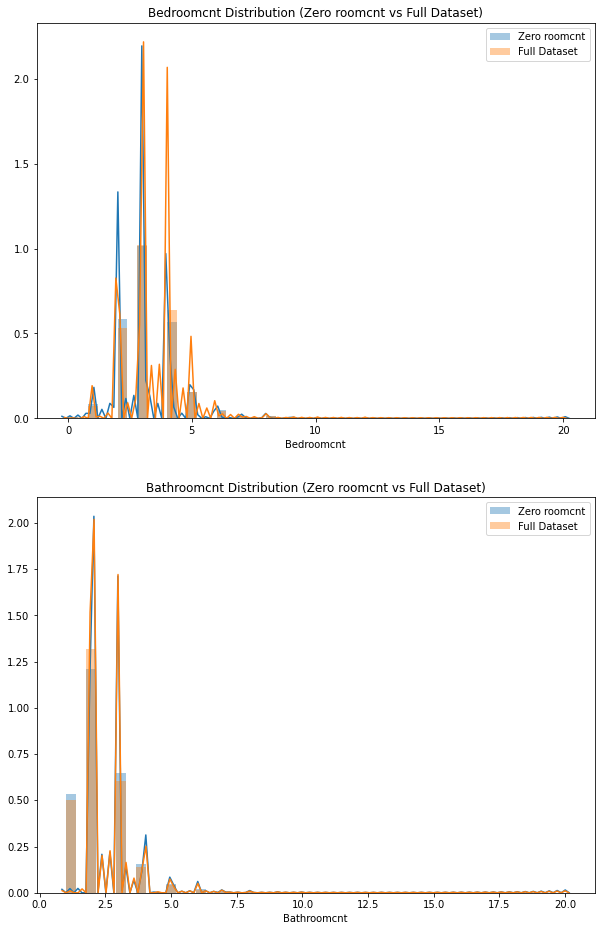

In [28]:
df = properties_df.sample(frac=0.2, random_state=1)
df_zero = df[df['roomcnt'] == 0]

fig, ax = plt.subplots(2,1,figsize=(10, 16))

sns.distplot(df_zero['bedroomcnt'], ax=ax[0], label="Zero roomcnt").set_title('Bedroomcnt Distribution (Zero roomcnt vs Full Dataset)')
sns.distplot(df['bedroomcnt'], ax=ax[0], label="Full Dataset")
ax[0].set(xlabel='Bedroomcnt')
ax[0].legend()
sns.distplot(df_zero['bathroomcnt'], ax=ax[1], label="Zero roomcnt").set_title('Bathroomcnt Distribution (Zero roomcnt vs Full Dataset)')
sns.distplot(df['bathroomcnt'], ax=ax[1], label="Full Dataset")
ax[1].set(xlabel='Bathroomcnt')
ax[1].legend()

plt.subplots_adjust(hspace = 0.2)
fig.show()

Nope.  No concentration here either.  The data seems to be missing randomly (there was most likely a randomized error in data collection or Zillow's preparation of this dataset).  So we can't fix the roomcnt column.  Even though we might expect that room count would be a great feature to have in our model, there is too much randomly missing data for it to be useful, and we expect that it would create unwanted bias and error.  Besides, bedroom count, bathroom count, and square feet, which have reasonable distributions, are good proxies for total room count anyway.  So let's drop the feature.

In [0]:
properties_df.drop(columns=['roomcnt'], inplace=True)
features = [x for x in features if x != 'roomcnt']
continuous_features = [x for x in continuous_features if x != 'roomcnt']

**Data Cleaning Summary**

To summarize, we have dropped 34 out of our original 58 columns (leaving us with 24 columns) and 6.1% of our original 5970434 rows (leaving us with 5609185 rows).  We are left with a good amount of clean and relevant data.

We have also determined that 17 of our columns will be used as features in our model, and our label will be totalvalue (though landvalue and housevalue could also potentially be used as features).

In [30]:
properties_df

,id,airconditioning,bathroomcnt,bedroomcnt,squarefeet,countyfips,fireplacecnt,fullbathcnt,garagecarcnt,garagetotalsqft,heatingorsystemtypeid,latitude,longitude,poolcnt,propertylandusetypeid,cityproxy,zipcodeproxy,threequarterbathcnt,yearbuilt,numberofstories,housevalue,totalvalue,assessmentyear,landvalue
19,11324547,1,2,4,3633,6037,0,2,0,0,2,34.560018,-118.169806,0,261,40227,97329,0,2005,1,218982,291973,2015,72991
26,11488147,0,4,5,2865,6037,0,4,0,0,0,33.879216,-118.361434,0,246,33612,96124,0,1972,1,267623,818739,2015,551116
28,11524947,1,2,2,1090,6037,0,2,0,0,2,33.974100,-118.423000,0,266,12447,96072,0,2004,1,229399,352198,2015,122799
29,11544747,1,4,3,1620,6037,0,4,0,0,2,33.996200,-118.438000,0,261,12447,96047,0,2011,1,334432,835036,2015,500604
31,11585547,0,2,3,2077,6037,0,2,0,0,2,34.012977,-118.479243,0,261,26964,96152,0,1926,1,207035,637046,2015,430011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2982279,12246525,1,6,8,4582,6037,0,6,0,0,0,33.879428,-118.302589,0,246,45398,96104,0,2012,1,450000,800000,2015,350000
2982280,11366340,0,1,2,798,6037,0,1,0,0,0,34.769356,-118.553521,0,263,5534,97319,0,2006,1,55200,469300,2016,414100
2982281,13010327,1,3,3,1526,6037,0,3,0,0,2,34.087735,-118.063008,0,266,14111,96517,0,2014,1,356454,594022,2016,237568
2982282,12385768,1,4,4,2110,6037,0,4,0,0,2,33.951985,-118.124097,1,261,4406,96100,0,2014,1,336548,554009,2016,217461


In [31]:
properties_df.dtypes

id                          int64
airconditioning          category
bathroomcnt                 int64
bedroomcnt                  int64
squarefeet                  int64
countyfips               category
fireplacecnt                int64
fullbathcnt                 int64
garagecarcnt                int64
garagetotalsqft             int64
heatingorsystemtypeid    category
latitude                  float64
longitude                 float64
poolcnt                     int64
propertylandusetypeid    category
cityproxy                category
zipcodeproxy             category
threequarterbathcnt         int64
yearbuilt                   int64
numberofstories             int64
housevalue                  int64
totalvalue                  int64
assessmentyear              int64
landvalue                   int64
dtype: object

Let's save this cleaned dataset as a csv in case we need it later.

In [0]:
properties_df.to_csv('/content/gdrive/My Drive/Colab Notebooks/CIS192_Final_Project/Data/cleaned_properties_df.csv')

In case you want access to this saved dataset, [here it is](https://drive.google.com/file/d/1tctO_PDhNvYzsx8ym2g6sMBsfgyE3AEE/view?usp=sharing).

# **Exploratory Data Analysis (EDA)**
We are done cleaning our data (spoiler alert, our future analysis exposes no further issues with data cleanliness).  But before we move on to construct our model, let's do some more EDA to sharpen our domain knowledge and further expose patterns and correlations in the data which may be useful to understand during model construction.

We analyze our continuous features above through overview statistics of the columns.  Let's now take a look at our categorical features.  Note that we have already analyzed propertylandusetypeid.

In [0]:
categorical_features

['airconditioning',
 'countyfips',
 'heatingorsystemtypeid',
 'propertylandusetypeid',
 'cityproxy',
 'zipcodeproxy']

We can analyze airconditioning similar to how we analyzed propertylandusetypeid.  Note that the majority of houses either don't have air conditioning or they have central air.

In [0]:
pd.DataFrame(properties_df.groupby('airconditioning').size().sort_values(ascending=False)\
             .apply(lambda x: ("%.3f" % (x/properties_df.shape[0]*100))+"%" ), columns=["% of Rows"])\
.apply(lambda x: addDesc(x, 'airconditioning'), axis=1)

,% of Rows,Type Description
airconditioning,,
0,71.944%,None
1,25.654%,Central
13,1.998%,Yes
5,0.305%,None
11,0.064%,Wall Unit
9,0.033%,Refrigeration
12,0.002%,Window Unit
3,0.000%,Evaporative Cooler


And for heatingorsystemtypeid, the breakdown seems to be more evenly divided among none, central air, and floor/wall heating.

In [0]:
pd.DataFrame(properties_df.groupby('heatingorsystemtypeid').size().sort_values(ascending=False)\
             .apply(lambda x: ("%.3f" % (x/properties_df.shape[0]*100))+"%" ), columns=["% of Rows"])\
.apply(lambda x: addDesc(x, 'heatingorsystemtypeid'), axis=1)

,% of Rows,Type Description
heatingorsystemtypeid,,
2,40.473%,Central
0,35.876%,None
7,21.770%,Floor/Wall
6,0.964%,Forced air
24,0.744%,Yes
20,0.090%,Solar
13,0.048%,None
18,0.021%,Radiant
1,0.009%,Baseboard


We can look at the FIPS codes of our full dataset (https://www.weather.gov/hnx/cafips) to see that all of these houses are located in three counties in California: Ventura County (6111), Los Angeles County (6037), and Orange County (6059).

In [0]:
list(properties_df['countyfips'].unique())

[6037, 6059, 6111]

Our city codes and zip codes are purely categorical (the IDs cannot be used to determine the actual cities and zip codes represented, possibly also for legal reasons), but we can get a sense of the distribution among these categories regardless:

In [0]:
len(properties_df['cityproxy'].unique())

184

In [0]:
len(properties_df['zipcodeproxy'].unique())

395

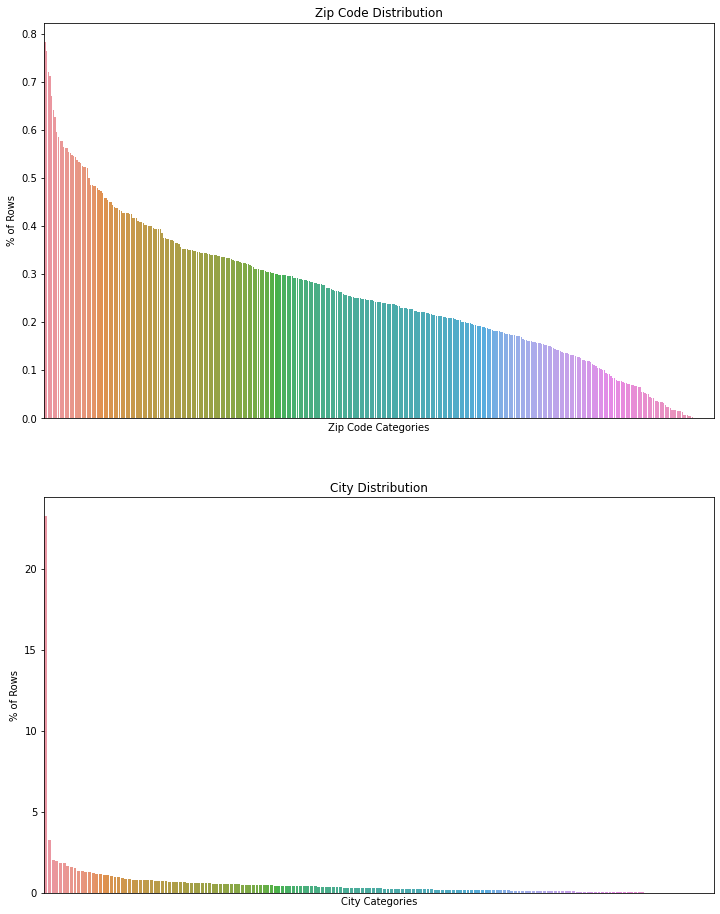

In [0]:
cityser = properties_df.groupby('cityproxy').size()\
             .sort_values(ascending=False)/properties_df.shape[0]*100

zipser = properties_df.groupby('zipcodeproxy').size()\
             .sort_values(ascending=False)/properties_df.shape[0]*100

fig, ax = plt.subplots(2,1,figsize=(12, 16))

sns.barplot(x=zipser.index, y=zipser, order=zipser.index, ax=ax[0],
            ci=None).set_title('Zip Code Distribution')
ax[0].set(xlabel='Zip Code Categories', ylabel='% of Rows')
ax[0].set_xticks([])
sns.barplot(x=cityser.index, y=cityser, order=cityser.index, ax=ax[1],
            ci=None).set_title('City Distribution')
ax[1].set(xlabel='City Categories', ylabel='% of Rows')
ax[1].set_xticks([])

plt.subplots_adjust(hspace = 0.2)
fig.show()

If I had to guess, I'd say that one city with a large share of our data is LA.  Let's see:

In [0]:
pd.DataFrame(properties_df.groupby('cityproxy').size().sort_values(ascending=False)\
             .apply(lambda x: ("%.3f" % (x/properties_df.shape[0]*100))+"%"), columns=["% of Rows"])

,% of Rows
cityproxy,
12447,23.252%
46298,3.234%
52650,2.025%
16764,1.967%
25218,1.869%
...,...
36078,0.000%
27512,0.000%
3980,0.000%


Ah yes, city 12447.  That would have been my next guess.  Unfortunately, due to Zillow's obfuscation of the data, we do not know what city this number corresponds to.  We could easily find out by plotting the geographical distribution of the homes in this city, but what's the point.  After all, our model will not know or care what the category labels mean.  This analysis was just to get a sense of the distribution of rows among categories.  So let's instead move on to analyzing the geographical distribution of the whole dataset.

Let's take a look at the histogram of values for latitude and longitude.

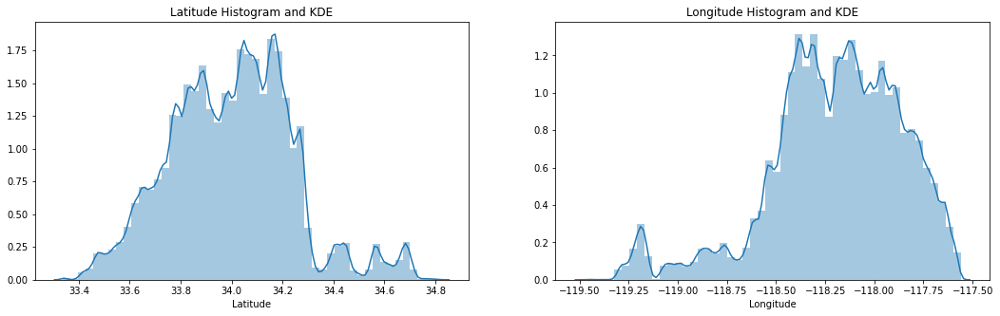

In [0]:
fig, ax = plt.subplots(1,2,figsize=(18, 5))

sns.distplot(properties_df['latitude'], ax=ax[0]).set_title('Latitude Histogram and KDE')
ax[0].set(xlabel='Latitude')
sns.distplot(properties_df['longitude'], ax=ax[1]).set_title('Longitude Histogram and KDE')
ax[1].set(xlabel='Longitude')

plt.subplots_adjust(hspace = 0.2)
fig.show()

We can visualize the geographical distribution of the homes in our dataset using a heatmap.  If you zoom in you can see the properties are fairly evenly distributed around these counties roughly according to a distribution in line with our latitude and longitude distributions.

In [0]:
random_sample = properties_df[['latitude', 'longitude', 'totalvalue']].sample(frac=0.01, random_state=1)

figure_layout = {
    'width': '1000px',
    'height': '1000px',
    'border': '1px solid black',
    'padding': '1px'
}

fig = gmaps.figure(map_type='HYBRID', layout=figure_layout)
heatmap_layer = gmaps.heatmap_layer(random_sample[['latitude', 'longitude']])
fig.add_layer(heatmap_layer)

embed_minimal_html('heatmap.html', views=[fig])
display(HTML(filename='heatmap.html'))

Here are some views of the map since it doesn't seem to save in the notebook after it is closed:

![alt text](https://i.imgur.com/YNrsGvWl.jpg)

![alt text](https://i.imgur.com/dg8D6i0l.jpg)

![alt text](https://i.imgur.com/4412JAGl.jpg)


Let's also look at a heatmap of our dataset weighted by property value.  If you zoom in, a few neighborhoods seem to be especially valuable (as we would expect): for instance, Beverly Hills, Santa Monica, and Pasadena.  On the other hand, neighborhoods like East Los Angeles and Compton seem to have less valuable homes.  This clustering together of more valuable and less valuable properties indicates that our zip code category may end up being an important feature in our models.

In [0]:
fig = gmaps.figure(map_type='HYBRID', layout=figure_layout)

heatmap_layer = gmaps.heatmap_layer(random_sample[['latitude', 'longitude']], 
                                    weights=random_sample['totalvalue'])#,max_intensity=10000, point_radius=20.0)
fig.add_layer(heatmap_layer)

embed_minimal_html('weighted_heatmap.html', views=[fig])
display(HTML(filename='weighted_heatmap.html'))

![alt text](https://i.imgur.com/08NjGgnl.jpg)

![alt text](https://i.imgur.com/za8fcQBl.jpg)

Now that we have a sense of the geographical distribution of our datasets, and how neighborhoods can correlate to house value, let's search for more potential correlations.  Since we have multiple tax assesed values (land value, house value, and total property value), let's plot land value vs house value to see if there are any visual correlations or patterns.

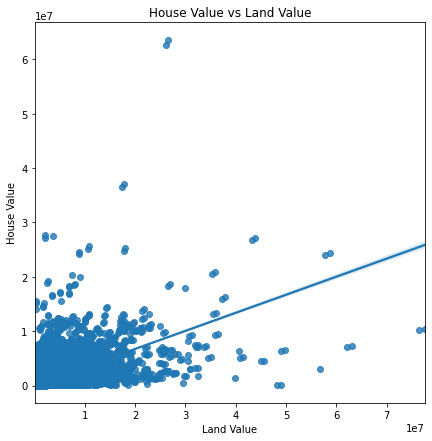

In [0]:
fig, ax = plt.subplots(figsize=(7,7))

sns.regplot(y=properties_df['housevalue'], x=properties_df['landvalue']).set_title('House Value vs Land Value')
ax.set(ylabel='House Value')
ax.set(xlabel='Land Value')

fig.show()

Let's check numerically if there is any correlation here.

In [0]:
properties_df['housevalue'].corr(properties_df['landvalue'])

0.6297757281334608

There indeed seems to be some positive correlation -- not weak but not incredibly strong either.  Some correlation would make sense, as one would expect more expensive houses would most likely be built on expensive property (if someone can afford and wants an expensive house, they probably can also afford and want good property).

Given that land value and house value are correlated, we can feel more comfortable using total value (their sum) as our label.  Besides, this is the closest proxy we have to market price (as discussed above), and we are hoping to build a good model for predicting the market price of real estate (that's where the money can be made, after all).

To get a sense of the correlations within our data, let's plot an assosiation map of all of our features and our label.  We will use dython's assosiations function, which takes care of mixed continuous/categorical data by using:

 * Pearson's R for continuous-continuous cases  
 * Correlation Ratio for categorical-continuous cases  
 * Cramer's V or Theil's U for categorical-categorical cases

In [0]:
properties_df_asc = properties_df.loc[:, features+['totalvalue']]
for cf in categorical_features:
  properties_df_asc[cf] = properties_df_asc[cf].astype(int)

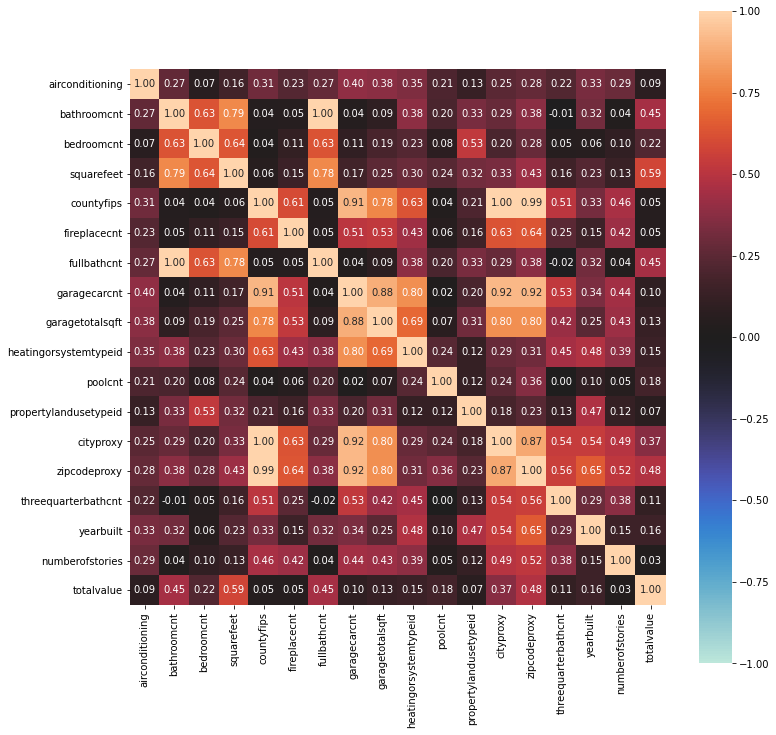

In [0]:
nominal.associations(properties_df_asc, nominal_columns=list(categorical_features), figsize=(12,12))
plt.show()

If we look at the bottom row, we can see how our features correlate with total value.  The best predictors of value seem to be bathroom count, full bath count, square feet, zip code, and city (as we predicted above based on our geographical analysis). Other good predictors of value include bedroom count, pool count, and year built.

If we look for other inter-feature correlations, a few reasonable ones are apparent.  For instance, garage total square feet is strongly correlated with garage total car count, fireplace count is correlated with room count, land use id is correlated with bedroom count, and bedroom count, bathroom count, and square feet are pairwise correlated.  Some other intereting correlations are apparent: room count, fireplace count, garage car count, and number of stories are all correlated with county, city, and zip code; this can probably be explained by the fact that houses in the suburbs are generally bigger, are more likely to have garages, and apparently may also have more fireplaces than houses in the more densely populated city.

Let's take a look at the distribution of year built, and how house value changes with year built (in more detail than a summary correlation value can give us):

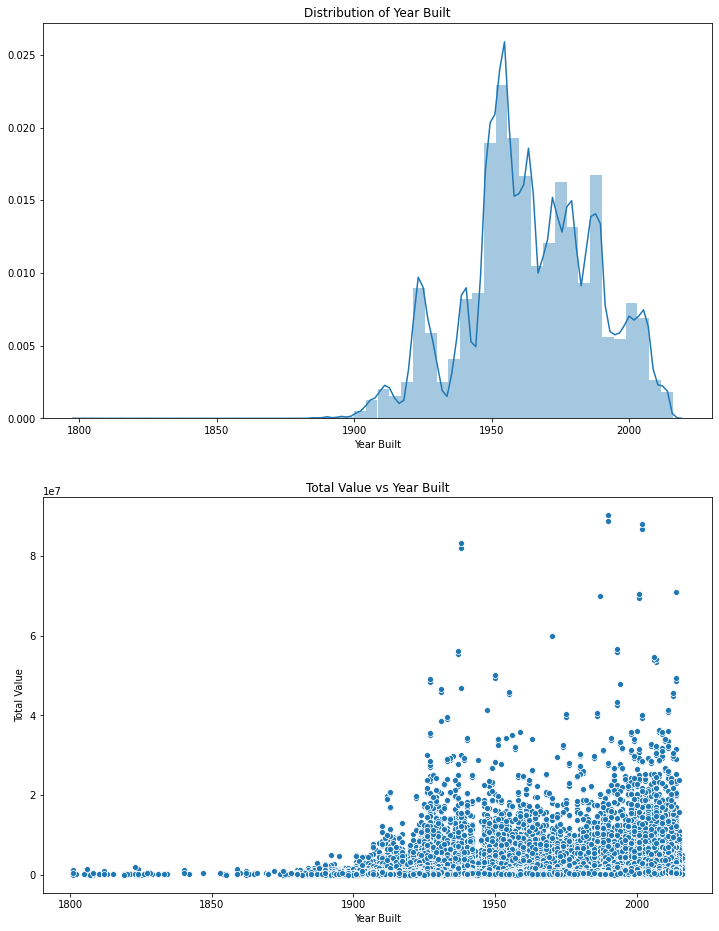

In [0]:
fig, ax = plt.subplots(2,1,figsize=(12, 16))

sns.distplot(properties_df['yearbuilt'], ax=ax[0])\
.set_title('Distribution of Year Built')
ax[0].set(xlabel='Year Built')

sns.scatterplot(x=properties_df['yearbuilt'], 
             y=properties_df['totalvalue'],
             ax=ax[1])\
.set_title('Total Value vs Year Built')
ax[1].set(xlabel='Year Built', ylabel='Total Value')

plt.subplots_adjust(hspace = 0.2)
fig.show()

Most of our houses are concentrated between 1950 and the present, with noticeably large dips during recessions and a steady rise during the housing bubble leading up to the great recession.

Also, from our second plot, we can gather that there is an awkward dip in house value between the WW2 / pre-war period houses (which are more likely to be regarded as antiques or nostalgic by rich old people), and homes built in the modern era (most likely garnished with modern technology and architecture, increasing value).  This could be explained by more valuable houses on either side (as explained), or it could possibly reflect cheaper homes being built during the rise of suburbia and housing market lows of the cold-war era (leading to lower house quality).  Note that nothing before 1900 is significantly valuable, which may be a reflection of the geographical area and/or the fact that pre-1900s is a little too antique for even the most nostalgic of rich old people.

# **Modeling**

We now begin our modeling section, in which we attempt to develop machine learning models which can predict real estate value.  Although, in a way, all of our work and analysis leading up to this section has been part of the modeling.

**Dimensionality Reduction, Categorical Embedding**

Since we will be trying out a linear regression model, we will need to figure out how to embed our categorical variables.  One way to do this is to one-hot-encode them, and then run PCA.  We will first scale/center our continuous features (such that they are centered and of unit variance).  Then, we will take care to center and scale the one-hot-encoded columns such that the variances of the OHE'd constituents of each originally categorical feature sum to 1.  Thus no feature gets an advantage in explaining more variance, categorical or not.

We will first start by simply running PCA on the continuous features.

In [0]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [0]:
pca = PCA(n_components=len(continuous_features))
pca.fit(StandardScaler().fit_transform(properties_df[continuous_features].to_numpy()))

[("{:.5f}".format(x*100.0))+"%" for x in pca.explained_variance_ratio_]

['34.33268%',
 '24.65954%',
 '9.01597%',
 '8.62233%',
 '6.54837%',
 '6.11938%',
 '4.29993%',
 '3.45691%',
 '2.06990%',
 '0.87042%',
 '0.00458%']

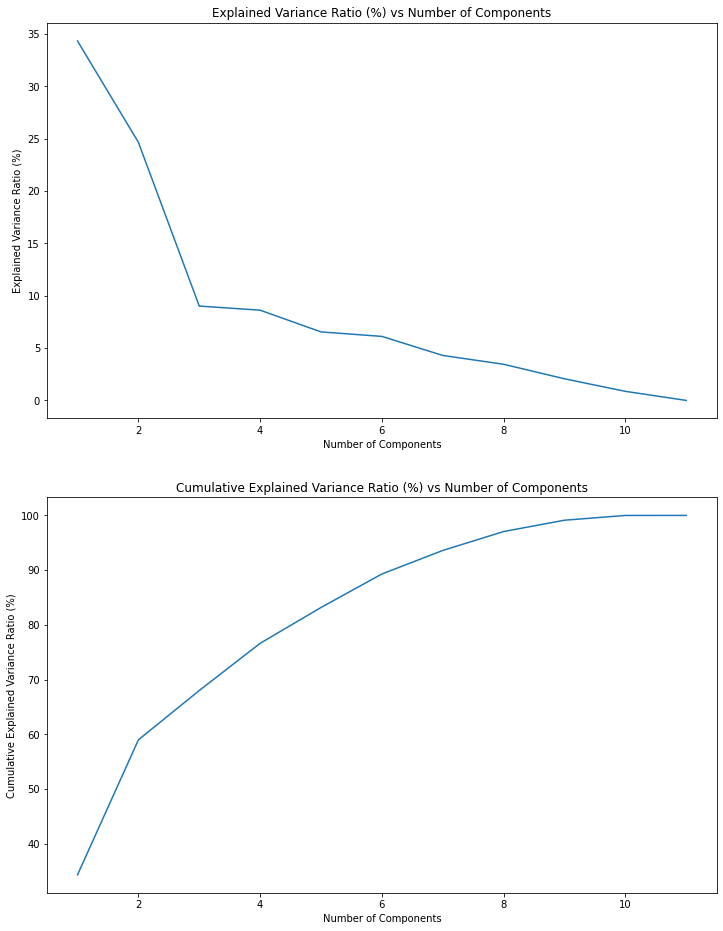

In [0]:
fig, ax = plt.subplots(2,1,figsize=(12, 16))

sns.lineplot(x=[1+x for x in range(len(pca.explained_variance_ratio_))], 
             y=pca.explained_variance_ratio_*100,
             ax=ax[0])\
.set_title('Explained Variance Ratio (%) vs Number of Components')
ax[0].set(xlabel='Number of Components', ylabel='Explained Variance Ratio (%)')

sns.lineplot(x=[1+x for x in range(len(pca.explained_variance_ratio_))], 
             y=pca.explained_variance_ratio_.cumsum()*100,
             ax=ax[1])\
.set_title('Cumulative Explained Variance Ratio (%) vs Number of Components')
ax[1].set(xlabel='Number of Components', ylabel='Cumulative Explained Variance Ratio (%)')

plt.subplots_adjust(hspace = 0.2)
fig.show()

This may seem slightly disappointing; there is no clear or optimal elbow point in the cumulative explained variance chart.  Rest at ease; one hot encoding of the categorical features will come to the rescue.

**Saving Memory and Processing Power Through Sampled Analysis**

We have reached the limits of what we can do with our entire dataset using the meager resources allocated to us by Google through Collab.  The analysis and model-tuning to come is too complex in memory usage and computational power.  So for now, we will deal with a smaller (randomized) sample of our data.  Eventually, once we have chosen our optimal model, we will figure out how to train it with all of our data (potentially using AWS).

In [0]:
sampled_properties_df = properties_df.sample(frac=0.1, random_state=1)

In [0]:
from sklearn.model_selection import train_test_split

_, test_df = train_test_split(sampled_properties_df, test_size=0.2)
train_df, validation_df = train_test_split(_, test_size=0.25)
del _

# ^ performs a 60:20:20 train:validation:test split

In [0]:
scaler = StandardScaler()
X_train = scaler.fit_transform(train_df[continuous_features].to_numpy())
y_train = train_df['totalvalue'].to_numpy()
X_val = scaler.transform(validation_df[continuous_features].to_numpy())
y_val = validation_df['totalvalue'].to_numpy()
X_test = scaler.transform(test_df[continuous_features].to_numpy())
y_test = test_df['totalvalue'].to_numpy()

Now, let's one-hot-encode our categorical variables and introduce them into our PCA, properly maintaining the variance of each categorical feature to be roughly unit in the resulting dataset, despite the one-hot-encoding.

Here we make sure to only apply the centering / scaling parameters calculated from our training set to the rest of the dataset (as this is part of our model).

In [0]:
column_stats = {}

def func(c):
  column_stats[c.name] = (c.mean(), c.std())
  return ((c - c.mean())/(c.std()*sqrtNumCats) if c.std() != 0 else (c - c.mean()))

def aux_func(c):
  m = column_stats[c.name][0]
  s = column_stats[c.name][1]
  return (c - m/(s*sqrtNumCats) if s != 0 else (c - m))

for col in categorical_features:
  sqrtNumCats = math.sqrt(len(train_df[col].unique()))
  column_stats = {}
  X_train = np.hstack((X_train, pd.get_dummies(train_df[[col]])\
                 .apply(lambda c: func(c))))
  X_val = np.hstack((X_val, pd.get_dummies(validation_df[[col]])\
                 .apply(lambda c: aux_func(c))))
  X_test = np.hstack((X_test, pd.get_dummies(test_df[[col]])\
                 .apply(lambda c: aux_func(c))))

Now, let's figure out how many components we want to take from PCA.

In [0]:
pca = PCA(n_components=int(X_train.shape[1]/2))
pca.fit(X_train)

PCA(copy=True, iterated_power='auto', n_components=315, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

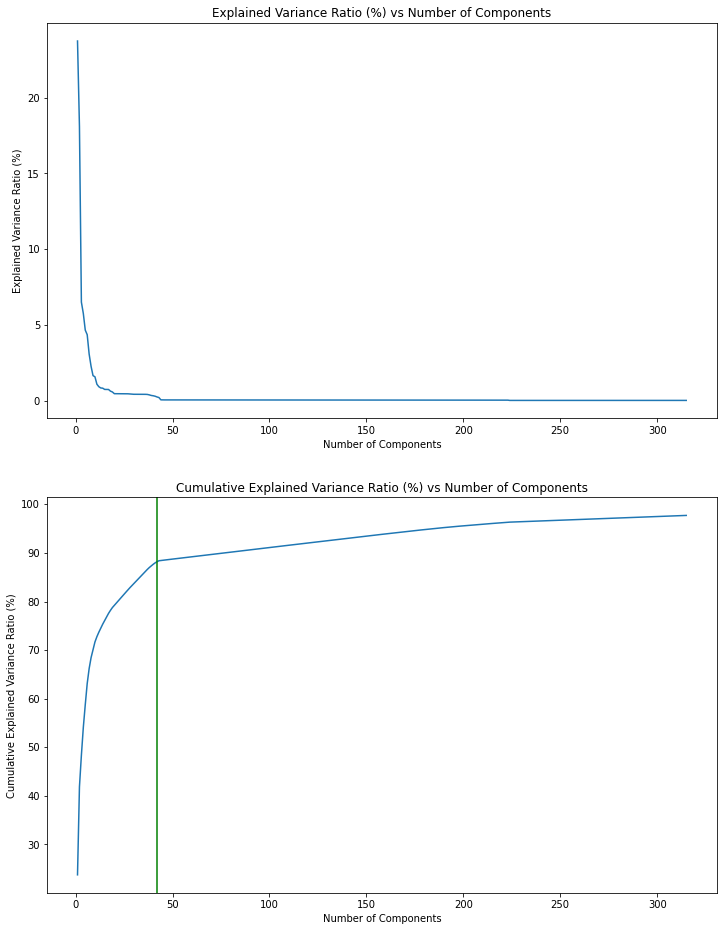

In [0]:
fig, ax = plt.subplots(2,1,figsize=(12, 16))

sns.lineplot(x=[1+x for x in range(len(pca.explained_variance_ratio_))], 
             y=pca.explained_variance_ratio_*100,
             ax=ax[0])\
.set_title('Explained Variance Ratio (%) vs Number of Components')
ax[0].set(xlabel='Number of Components', ylabel='Explained Variance Ratio (%)')

sns.lineplot(x=[1+x for x in range(len(pca.explained_variance_ratio_))], 
             y=pca.explained_variance_ratio_.cumsum()*100,
             ax=ax[1])\
.set_title('Cumulative Explained Variance Ratio (%) vs Number of Components')
ax[1].set(xlabel='Number of Components', ylabel='Cumulative Explained Variance Ratio (%)')

plt.axvline(42, 0, 20, color='green')

plt.subplots_adjust(hspace = 0.2)
fig.show()

A nice elbow point with a high explained variance occurs at around 42 components.  Note that we get a higher explained variance ratio than we did only using the continuous variables, indicating that our one-hot-encoding of categorical variables seemed to help (though, admittedly, this is a very crude metric of success).  Taking only 42 out of our 624 components should also limit overfitting.  So let's retrain our PCA model for 42 components.

In [0]:
pca = PCA(n_components=42)
pca.fit(X_train)

PCA(copy=True, iterated_power='auto', n_components=42, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

We interrupt your regularly scheduled programming to bring you some T-SNE visualization.

In [0]:
from sklearn.manifold import TSNE

In [0]:
df = sampled_properties_df[features+['totalvalue']].sample(frac=0.1, random_state=0)
ss_properties = df[features].to_numpy()

In [0]:
X_embedded = TSNE(n_components=2, verbose=10).fit_transform(ss_properties)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 56092 samples in 0.208s...
[t-SNE] Computed neighbors for 56092 samples in 3.183s...
[t-SNE] Computed conditional probabilities for sample 1000 / 56092
[t-SNE] Computed conditional probabilities for sample 2000 / 56092
[t-SNE] Computed conditional probabilities for sample 3000 / 56092
[t-SNE] Computed conditional probabilities for sample 4000 / 56092
[t-SNE] Computed conditional probabilities for sample 5000 / 56092
[t-SNE] Computed conditional probabilities for sample 6000 / 56092
[t-SNE] Computed conditional probabilities for sample 7000 / 56092
[t-SNE] Computed conditional probabilities for sample 8000 / 56092
[t-SNE] Computed conditional probabilities for sample 9000 / 56092
[t-SNE] Computed conditional probabilities for sample 10000 / 56092
[t-SNE] Computed conditional probabilities for sample 11000 / 56092
[t-SNE] Computed conditional probabilities for sample 12000 / 56092
[t-SNE] Computed conditional probabilities for sam

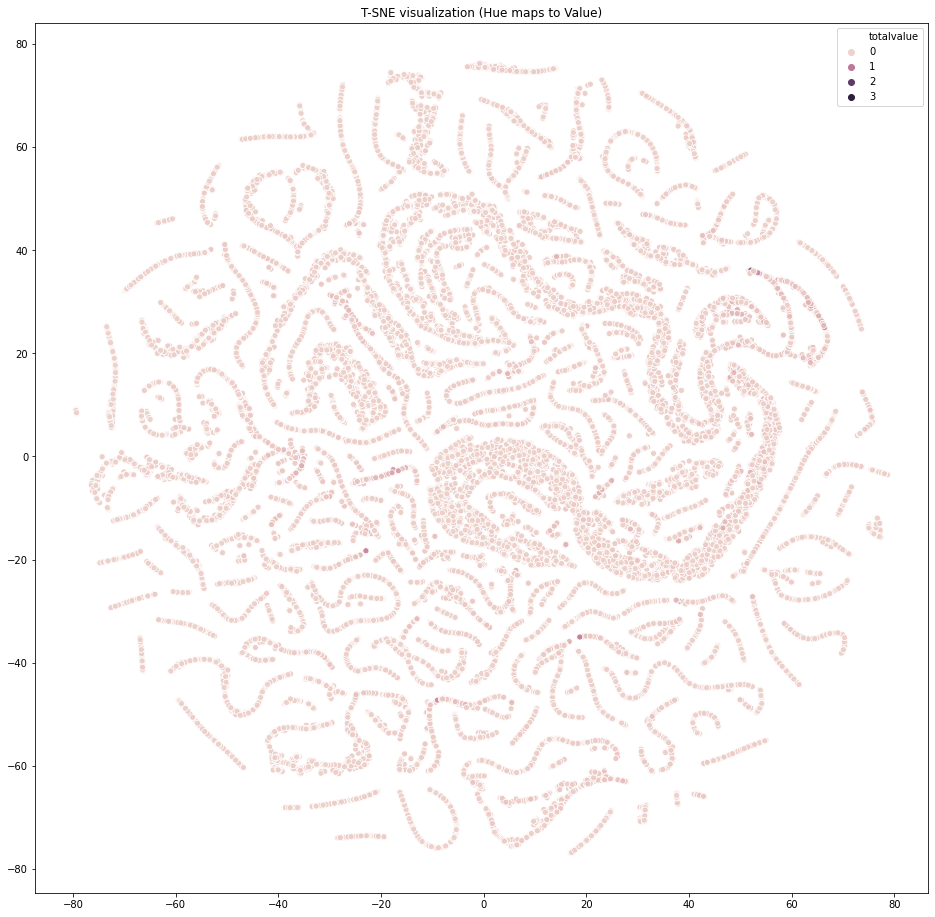

In [0]:

fig, ax = plt.subplots(figsize=(12, 12))

sns.scatterplot(x=X_embedded[:, 0], 
             y=X_embedded[:, 1],
             hue = df['totalvalue'],
             ax=ax)\
.set_title('T-SNE visualization (Hue maps to Value)')

fig.show()


Now, let's train a linear regression model to try to predict total value.

In [0]:
from sklearn.linear_model import LinearRegression

In [0]:
reg = LinearRegression().fit(pca.transform(X_train), y_train)

In [0]:
reg.score(pca.transform(X_train), y_train)

0.4018772444298105

In [0]:
reg.score(pca.transform(X_val), y_val)

0.39684533478671724

So our linear regression model has a score of 41%.  If we were happy with this score, we could try various regularization strategies such as Lasso, Ridge, or ElasticNet to try to reduce overfitting and get our model ready to pack up and ship.  However, while this is an OK score for such a complex prediction, I am not satisfied yet.  Let's try some more ML models and we will return to the best one.

Next, let's try out a decision tree.

In [0]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor

In [0]:
parameters = {'max_depth':[2, 4, 8, 12, 16]}
clf = GridSearchCV(DecisionTreeRegressor(random_state=0), parameters, verbose=10)
clf.fit(pca.transform(X_train), y_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits
[CV] max_depth=2 .....................................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV] ......................... max_depth=2, score=0.158, total=   3.4s
[CV] max_depth=2 .....................................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    3.4s remaining:    0.0s


[CV] ......................... max_depth=2, score=0.244, total=   3.4s
[CV] max_depth=2 .....................................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    6.8s remaining:    0.0s


[CV] ......................... max_depth=2, score=0.207, total=   3.4s
[CV] max_depth=2 .....................................................


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   10.2s remaining:    0.0s


[CV] ......................... max_depth=2, score=0.219, total=   3.4s
[CV] max_depth=2 .....................................................


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   13.6s remaining:    0.0s


[CV] ......................... max_depth=2, score=0.242, total=   3.4s
[CV] max_depth=4 .....................................................


[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   17.0s remaining:    0.0s


[CV] ......................... max_depth=4, score=0.267, total=   6.8s
[CV] max_depth=4 .....................................................


[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:   23.8s remaining:    0.0s


[CV] ......................... max_depth=4, score=0.380, total=   6.6s
[CV] max_depth=4 .....................................................


[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:   30.5s remaining:    0.0s


[CV] ......................... max_depth=4, score=0.339, total=   6.6s
[CV] max_depth=4 .....................................................


[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:   37.1s remaining:    0.0s


[CV] ......................... max_depth=4, score=0.328, total=   6.6s
[CV] max_depth=4 .....................................................


[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:   43.8s remaining:    0.0s


[CV] ......................... max_depth=4, score=0.351, total=   6.7s
[CV] max_depth=8 .....................................................
[CV] ......................... max_depth=8, score=0.310, total=  12.5s
[CV] max_depth=8 .....................................................
[CV] ......................... max_depth=8, score=0.181, total=  12.5s
[CV] max_depth=8 .....................................................
[CV] ......................... max_depth=8, score=0.378, total=  12.5s
[CV] max_depth=8 .....................................................
[CV] ......................... max_depth=8, score=0.333, total=  12.5s
[CV] max_depth=8 .....................................................
[CV] ......................... max_depth=8, score=0.340, total=  12.8s
[CV] max_depth=12 ....................................................
[CV] ........................ max_depth=12, score=0.181, total=  17.4s
[CV] max_depth=12 ....................................................
[CV] .

[Parallel(n_jobs=1)]: Done  25 out of  25 | elapsed:  5.1min finished


GridSearchCV(cv=None, error_score=nan,
             estimator=DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse',
                                             max_depth=None, max_features=None,
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             presort='deprecated',
                                             random_state=0, splitter='best'),
             iid='deprecated', n_jobs=None,
             param_grid={'max_depth': [2, 4, 8, 12, 16]},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=10)

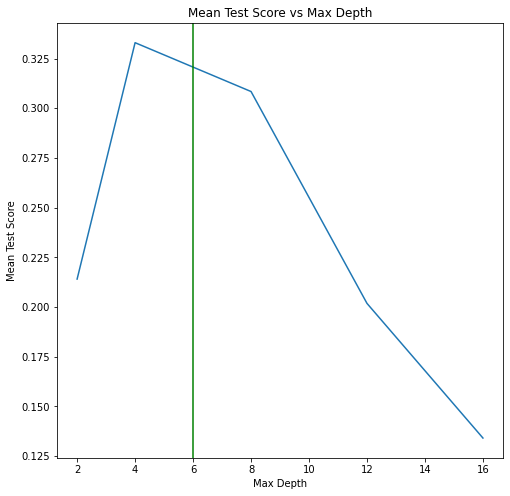

In [0]:
length = len(clf.cv_results_['mean_test_score'])

scores = pd.DataFrame({'max_depth': [clf.cv_results_['params'][i]['max_depth'] for i in range(length)], 
 'mean_test_score': [clf.cv_results_['mean_test_score'][i] for i in range(length)]})

fig, ax = plt.subplots(figsize=(8, 8))

sns.lineplot(data=scores, y='mean_test_score', x='max_depth', ax=ax)\
.set_title('Mean Test Score vs Max Depth')
ax.set(xlabel='Max Depth', ylabel='Mean Test Score')

plt.axvline(6, 0, 1, color='green')

fig.show()

In [0]:
tree = DecisionTreeRegressor(random_state=1, max_depth=6)

In [0]:
tree.fit(pca.transform(X_train), y_train)

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=6,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=1, splitter='best')

In [0]:
tree.score(pca.transform(X_train), y_train)

0.4688018643298493

In [0]:
tree.score(pca.transform(X_val), y_val)

0.10828212671090454

Our lonely tree seems to have suffered from severe overfitting, and it barely even beat the linear regression on the its training set.  However, when a single tree might snap, a bundle of trees can be strong.  Let's see if an ensemble can improve our score; our next model will be a Random Forest.

In [0]:
parameters = {'n_estimators':[2, 4, 8, 16], 
              'max_depth': [2, 4, 6]}
clf = GridSearchCV(RandomForestRegressor(random_state=0, verbose=10), parameters, verbose=10)
clf.fit(X_train, y_train)

Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV] max_depth=2, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   10.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   12.5s remaining:    0.0s


[CV] ......... max_depth=2, n_estimators=2, score=0.340, total=  12.5s
[CV] max_depth=2, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   10.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   24.7s remaining:    0.0s


[CV] ......... max_depth=2, n_estimators=2, score=0.358, total=  12.2s
[CV] max_depth=2, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   10.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   36.7s remaining:    0.0s


[CV] ......... max_depth=2, n_estimators=2, score=0.356, total=  11.9s
[CV] max_depth=2, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   10.7s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   48.6s remaining:    0.0s


[CV] ......... max_depth=2, n_estimators=2, score=0.363, total=  11.9s
[CV] max_depth=2, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   10.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:  1.0min remaining:    0.0s


[CV] ......... max_depth=2, n_estimators=2, score=0.341, total=  12.1s
[CV] max_depth=2, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   21.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:  1.4min remaining:    0.0s


[CV] ......... max_depth=2, n_estimators=4, score=0.368, total=  22.8s
[CV] max_depth=2, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   21.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:  1.8min remaining:    0.0s


[CV] ......... max_depth=2, n_estimators=4, score=0.387, total=  22.7s
[CV] max_depth=2, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   21.7s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  2.2min remaining:    0.0s


[CV] ......... max_depth=2, n_estimators=4, score=0.386, total=  23.0s
[CV] max_depth=2, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   21.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:  2.5min remaining:    0.0s


[CV] ......... max_depth=2, n_estimators=4, score=0.380, total=  22.7s
[CV] max_depth=2, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   21.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=2, n_estimators=4, score=0.332, total=  22.7s
[CV] max_depth=2, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:   43.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=2, n_estimators=8, score=0.366, total=  44.4s
[CV] max_depth=2, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:   43.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=2, n_estimators=8, score=0.371, total=  44.6s
[CV] max_depth=2, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:   43.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=2, n_estimators=8, score=0.376, total=  44.5s
[CV] max_depth=2, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:   43.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=2, n_estimators=8, score=0.391, total=  44.5s
[CV] max_depth=2, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:   42.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=2, n_estimators=8, score=0.359, total=  44.3s
[CV] max_depth=2, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.0s finished


[CV] ........ max_depth=2, n_estimators=16, score=0.364, total= 1.5min
[CV] max_depth=2, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.0s finished


[CV] ........ max_depth=2, n_estimators=16, score=0.372, total= 1.5min
[CV] max_depth=2, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.0s finished


[CV] ........ max_depth=2, n_estimators=16, score=0.368, total= 1.5min
[CV] max_depth=2, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.0s finished


[CV] ........ max_depth=2, n_estimators=16, score=0.380, total= 1.5min
[CV] max_depth=2, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=2, n_estimators=16, score=0.338, total= 1.5min
[CV] max_depth=4, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   21.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=2, score=0.441, total=  23.0s
[CV] max_depth=4, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   21.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=2, score=0.300, total=  22.7s
[CV] max_depth=4, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   21.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=2, score=0.420, total=  22.9s
[CV] max_depth=4, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   21.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=2, score=0.450, total=  22.9s
[CV] max_depth=4, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   21.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=2, score=0.425, total=  22.8s
[CV] max_depth=4, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   42.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=4, score=0.445, total=  44.2s
[CV] max_depth=4, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   43.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=4, score=0.293, total=  44.7s
[CV] max_depth=4, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   44.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=4, score=0.420, total=  45.4s
[CV] max_depth=4, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   43.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=4, score=0.441, total=  44.9s
[CV] max_depth=4, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   42.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=4, score=0.425, total=  44.3s
[CV] max_depth=4, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=8, score=0.435, total= 1.5min
[CV] max_depth=4, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=8, score=0.373, total= 1.5min
[CV] max_depth=4, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=8, score=0.444, total= 1.5min
[CV] max_depth=4, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  1.4min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=8, score=0.458, total= 1.5min
[CV] max_depth=4, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  1.5min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.0s finished


[CV] ......... max_depth=4, n_estimators=8, score=0.425, total= 1.5min
[CV] max_depth=4, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  2.9min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=4, n_estimators=16, score=0.444, total= 2.9min
[CV] max_depth=4, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  2.9min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=4, n_estimators=16, score=0.338, total= 2.9min
[CV] max_depth=4, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  2.9min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=4, n_estimators=16, score=0.438, total= 2.9min
[CV] max_depth=4, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  2.9min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=4, n_estimators=16, score=0.462, total= 2.9min
[CV] max_depth=4, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  2.9min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=4, n_estimators=16, score=0.426, total= 2.9min
[CV] max_depth=6, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   31.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=2, score=0.417, total=  33.1s
[CV] max_depth=6, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   32.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=2, score=0.426, total=  33.3s
[CV] max_depth=6, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   32.9s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=2, score=0.433, total=  34.3s
[CV] max_depth=6, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   31.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=2, score=0.443, total=  32.9s
[CV] max_depth=6, n_estimators=2 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   32.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=2, score=0.430, total=  33.2s
[CV] max_depth=6, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  1.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=4, score=0.442, total= 1.1min
[CV] max_depth=6, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  1.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=4, score=0.420, total= 1.1min
[CV] max_depth=6, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  1.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=4, score=0.435, total= 1.1min
[CV] max_depth=6, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  1.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=4, score=0.475, total= 1.1min
[CV] max_depth=6, n_estimators=4 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  1.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished


[CV] ......... max_depth=6, n_estimators=4, score=0.383, total= 1.1min
[CV] max_depth=6, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  2.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s finished


[CV] ......... max_depth=6, n_estimators=8, score=0.459, total= 2.1min
[CV] max_depth=6, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  2.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s finished


[CV] ......... max_depth=6, n_estimators=8, score=0.364, total= 2.1min
[CV] max_depth=6, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  2.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s finished


[CV] ......... max_depth=6, n_estimators=8, score=0.457, total= 2.1min
[CV] max_depth=6, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  2.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s finished


[CV] ......... max_depth=6, n_estimators=8, score=0.484, total= 2.1min
[CV] max_depth=6, n_estimators=8 .....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  2.1min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:    0.1s finished


[CV] ......... max_depth=6, n_estimators=8, score=0.445, total= 2.1min
[CV] max_depth=6, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  4.2min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=6, n_estimators=16, score=0.480, total= 4.2min
[CV] max_depth=6, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  4.2min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=6, n_estimators=16, score=0.362, total= 4.2min
[CV] max_depth=6, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  4.2min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=6, n_estimators=16, score=0.451, total= 4.3min
[CV] max_depth=6, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  4.2min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished


[CV] ........ max_depth=6, n_estimators=16, score=0.493, total= 4.3min
[CV] max_depth=6, n_estimators=16 ....................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  4.2min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Done  60 out of  60 | elapsed: 81.5min finished


[CV] ........ max_depth=6, n_estimators=16, score=0.465, total= 4.3min


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  16 out of  16 | elapsed:  1.7min finished


GridSearchCV(cv=None, error_score=nan,
             estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                             criterion='mse', max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             max_samples=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators=100, n_jobs=None,
                                             oob_score=False, random_state=None,
                                             verbose=1, warm_start=False),
             iid='deprecated', n

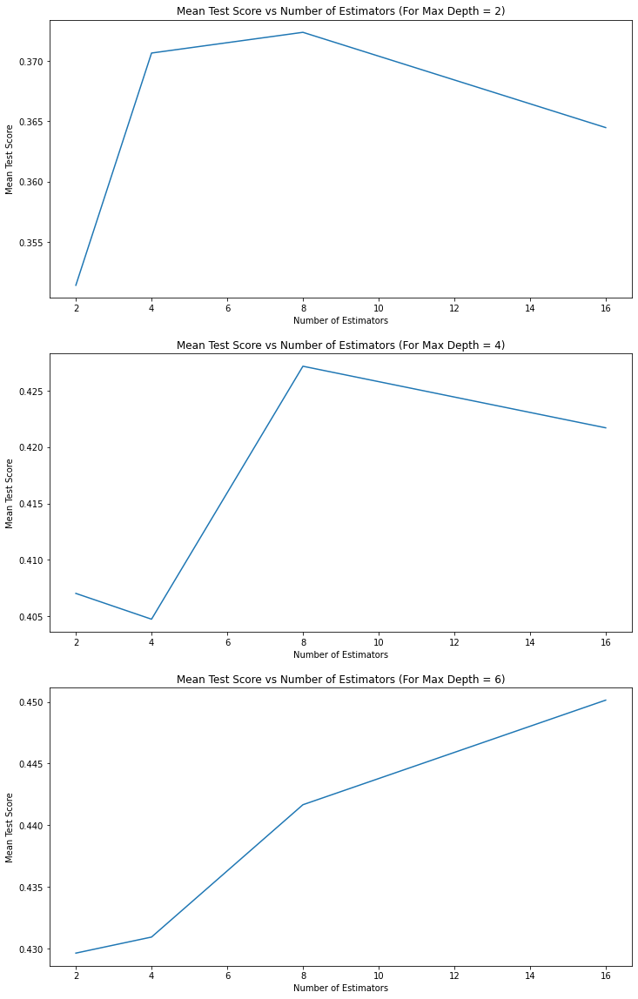

In [0]:
length = len(clf.cv_results_['mean_test_score'])

scores = pd.DataFrame({'max_depth': [clf.cv_results_['params'][i]['max_depth'] for i in range(length)], 
 'n_estimators': [clf.cv_results_['params'][i]['n_estimators'] for i in range(length)],
 'mean_test_score': [clf.cv_results_['mean_test_score'][i] for i in range(length)]})

fig, ax = plt.subplots(3,1,figsize=(12, 20))

sns.lineplot(data=scores[scores['max_depth'] == 2], y='mean_test_score', x='n_estimators', ax=ax[0])\
.set_title('Mean Test Score vs Number of Estimators (For Max Depth = 2)')
ax[0].set(xlabel='Number of Estimators', ylabel='Mean Test Score')

sns.lineplot(data=scores[scores['max_depth'] == 4], y='mean_test_score', x='n_estimators', ax=ax[1])\
.set_title('Mean Test Score vs Number of Estimators (For Max Depth = 4)')
ax[1].set(xlabel='Number of Estimators', ylabel='Mean Test Score')

sns.lineplot(data=scores[scores['max_depth'] == 6], y='mean_test_score', x='n_estimators', ax=ax[2])\
.set_title('Mean Test Score vs Number of Estimators (For Max Depth = 6)')
ax[2].set(xlabel='Number of Estimators', ylabel='Mean Test Score')

plt.subplots_adjust(hspace = 0.2)
fig.show()

At a max depth of 2, our accuracies are below that of our regression and lone tree of max depth 6.  At a max depth of 4, our accuracy seems to peak at a little above 42.5%, and at a max depth of 6, our accuracy seems to be leveling off but not necessarily peaking at 16 estimators.  So let's say the optimal is around a max depth of 6 and 20 estimators:

In [0]:
forest = RandomForestRegressor(random_state=0, verbose=10, 
                               max_depth=6, n_estimators=20)\
                               .fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


building tree 1 of 20


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    6.5s remaining:    0.0s


building tree 2 of 20


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   12.9s remaining:    0.0s


building tree 3 of 20


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   19.2s remaining:    0.0s


building tree 4 of 20


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   25.5s remaining:    0.0s


building tree 5 of 20


[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   31.9s remaining:    0.0s


building tree 6 of 20


[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:   38.3s remaining:    0.0s


building tree 7 of 20


[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:   44.6s remaining:    0.0s


building tree 8 of 20


[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:   51.0s remaining:    0.0s


building tree 9 of 20


[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:   57.4s remaining:    0.0s


building tree 10 of 20
building tree 11 of 20
building tree 12 of 20
building tree 13 of 20
building tree 14 of 20
building tree 15 of 20
building tree 16 of 20
building tree 17 of 20
building tree 18 of 20
building tree 19 of 20
building tree 20 of 20


[Parallel(n_jobs=1)]: Done  20 out of  20 | elapsed:  2.1min finished


In [0]:
forest.verbose = False
forest.score(X_train, y_train)

0.5158434401571372

In [0]:
forest.score(X_val, y_val)

0.49004929392145113

We have 49%, our best score yet.  More trees may have improved this score even more, but extending the grid search to higher n_estimator parameters would have taken far too long with the resources we are currently working with.  For this reason, we will later conduct a random forest grid search on MLLib and see if we can better tune our parameters.

Finally, let's try out a library for gradient boosted decision trees (similar to the Adaboost model discussed in lecture), called [CatBoost](https://catboost.ai/).

In [0]:
from catboost import CatBoostRegressor

In [0]:
cat = CatBoostRegressor(
    random_seed=42,
    logging_level='Silent'
)
cat = cat.fit(
    X_train, y_train,
    eval_set=(X_val, y_val),
    logging_level='Verbose',
)

Learning rate set to 0.138274
0:	learn: 532973.4252221	test: 527137.6093456	best: 527137.6093456 (0)	total: 40ms	remaining: 40s
1:	learn: 509594.2259403	test: 504368.1798517	best: 504368.1798517 (1)	total: 76.7ms	remaining: 38.3s
2:	learn: 490428.2652928	test: 486495.0544684	best: 486495.0544684 (2)	total: 116ms	remaining: 38.5s
3:	learn: 475471.6923390	test: 472242.5876823	best: 472242.5876823 (3)	total: 153ms	remaining: 38s
4:	learn: 463078.7255667	test: 461139.4343174	best: 461139.4343174 (4)	total: 189ms	remaining: 37.5s
5:	learn: 452425.8914399	test: 451644.2079104	best: 451644.2079104 (5)	total: 230ms	remaining: 38.1s
6:	learn: 443702.9705151	test: 444563.2272041	best: 444563.2272041 (6)	total: 269ms	remaining: 38.2s
7:	learn: 436715.3689543	test: 437694.3894560	best: 437694.3894560 (7)	total: 305ms	remaining: 37.9s
8:	learn: 430656.7729630	test: 431159.5376887	best: 431159.5376887 (8)	total: 340ms	remaining: 37.5s
9:	learn: 425611.5337741	test: 427283.9164657	best: 427283.916465

In [0]:
y_train_pred = cat.predict(X_train)
y_val_pred = cat.predict(X_val)

In [0]:
sklearn.metrics.r2_score(y_train, y_train_pred)

0.71877548504212

In [0]:
sklearn.metrics.r2_score(y_val, y_val_pred)

0.5737865374573043

In [0]:
cat_raw = CatBoostRegressor(
    random_seed=42,
    cat_features=categorical_features,
    logging_level='Silent'
)
cat_raw = cat_raw.fit(
    train_df[features], train_df['totalvalue'],
    cat_features=categorical_features,
    eval_set=(validation_df[features], validation_df['totalvalue']),
    logging_level='Verbose', 
)

Learning rate set to 0.138274
0:	learn: 533221.5531463	test: 526366.2108007	best: 526366.2108007 (0)	total: 270ms	remaining: 4m 29s
1:	learn: 505734.4006447	test: 500027.2200652	best: 500027.2200652 (1)	total: 510ms	remaining: 4m 14s
2:	learn: 482648.9361093	test: 478224.5283535	best: 478224.5283535 (2)	total: 728ms	remaining: 4m 1s
3:	learn: 464141.5963752	test: 460722.0166234	best: 460722.0166234 (3)	total: 925ms	remaining: 3m 50s
4:	learn: 449431.9803704	test: 446263.3692853	best: 446263.3692853 (4)	total: 1.1s	remaining: 3m 40s
5:	learn: 437336.4148692	test: 435214.1396047	best: 435214.1396047 (5)	total: 1.33s	remaining: 3m 41s
6:	learn: 427521.8030012	test: 426224.9390037	best: 426224.9390037 (6)	total: 1.53s	remaining: 3m 37s
7:	learn: 419918.6640318	test: 418870.7536851	best: 418870.7536851 (7)	total: 1.74s	remaining: 3m 36s
8:	learn: 413514.8241397	test: 412956.1193686	best: 412956.1193686 (8)	total: 1.92s	remaining: 3m 31s
9:	learn: 408291.2382356	test: 408116.0600685	best: 40

In [0]:
y_train_pred = cat_raw.predict(train_df[features])
y_val_pred = cat_raw.predict(validation_df[features])

In [0]:
sklearn.metrics.r2_score(y_train, y_train_pred)

0.6671709492349633

In [0]:
sklearn.metrics.r2_score(y_val, y_val_pred)

0.5721163380892472

Catboost seems to be a significant improvement over our other models, including our random forest.  However, one of Catboost's main selling points is its superiority in category embedding.  We ran catboost on the purely numerical outputs of our one-hot-encoding/PCA embedding and on the original mixed continuous/categorical dataset, and it yielded similar accuracies.  While accuracy is only one metric and it does not take into account other important factors such as overfitting, catboost doesn't seem to live up to its name in this respect.

Our main improvement most likely comes from the fact that catboost is a library for gradient boosting.  The informed construction and weighting of new decision trees based on past successes and difficulties results in the forest being much better suited to accurately handling the decision problems.

Now that we are done tuning all hyperparameters, let's use our test data to yield an unbiased evaluation of all of our models so far:

In [0]:
reg.score(pca.transform(X_test), y_test)

0.3869381083951192

In [0]:
tree.score(pca.transform(X_test), y_test)

-0.09704383338754319

In [0]:
forest.verbose = False
forest.score(X_test, y_test)

0.5111029778105174

In [0]:
sklearn.metrics.r2_score(y_test, cat.predict(X_test))

0.546749149195332

In [0]:
sklearn.metrics.r2_score(y_test, cat_raw.predict(test_df[features]))

0.576960527813235

So it turns out gradient boosted trees yield our best accuracy score, at around 58%.  The algorithm's own categorical embedding algorithm seems to suit its purposes better than our one-hot-encoding / PCA embedding, but not by much; feeding our data through PCA and then running it though CatBoost yielded a final accuracy score of around 55%.  Note that, while these accuracy scores seem low, they are actually quite high for such a complex predictive task and for using data which has been limited in many ways due to legal limitations on the release of data proprietary to the National Association of Realtors.

Let's train and export our best model, raw Catboost, so that we can use it on the backend of our house price prediction API.  We will use a GPU hardware accelerator through Collab to get the job done.

In [0]:
del train_df
del test_df
del validation_df
del sampled_properties_df
# ^ to save RAM

_, final_test_df = train_test_split(properties_df, test_size=0.2)
final_train_df, final_validation_df = train_test_split(_, test_size=0.25)
del _

In [57]:
cat_final = CatBoostRegressor(
    random_seed=42,
    cat_features=categorical_features,
    logging_level='Silent',
    task_type="GPU",
    devices='0:1',
    # iterations=1000
)
cat_final = cat_final.fit(
    final_train_df[features], final_train_df['totalvalue'],
    cat_features=categorical_features,
    eval_set=(final_validation_df[features], final_validation_df['totalvalue']),
    logging_level='Verbose', 
    )

Learning rate set to 0.280947
0:	learn: 527678.8783585	test: 528589.3207682	best: 528589.3207682 (0)	total: 201ms	remaining: 3m 20s
1:	learn: 487118.6363107	test: 487220.4639317	best: 487220.4639317 (1)	total: 400ms	remaining: 3m 19s
2:	learn: 460640.5276228	test: 460932.7814450	best: 460932.7814450 (2)	total: 603ms	remaining: 3m 20s
3:	learn: 446357.9932721	test: 447105.9467472	best: 447105.9467472 (3)	total: 768ms	remaining: 3m 11s
4:	learn: 434083.7709790	test: 435339.6924312	best: 435339.6924312 (4)	total: 974ms	remaining: 3m 13s
5:	learn: 427185.0326911	test: 429076.7473037	best: 429076.7473037 (5)	total: 1.21s	remaining: 3m 20s
6:	learn: 421078.8658526	test: 423657.0053859	best: 423657.0053859 (6)	total: 1.4s	remaining: 3m 19s
7:	learn: 416491.2884147	test: 419300.6748725	best: 419300.6748725 (7)	total: 1.59s	remaining: 3m 17s
8:	learn: 412387.8792918	test: 415779.1465537	best: 415779.1465537 (8)	total: 1.77s	remaining: 3m 15s
9:	learn: 409260.2134035	test: 412912.5239910	best: 4

Let's score our model:

In [78]:
sklearn.metrics.r2_score(final_test_df['totalvalue'], cat_final.predict(final_test_df[features]))

0.601818004335132

Not bad at all: 60.1%.  Let's export our model for use in our API.

In [0]:
cat_final.save_model(format="cbm", 
                     fname="/content/gdrive/My Drive/Colab Notebooks/CIS192_Final_Project/Model/CatboostModel.cbm",
                     pool=final_train_df[features])

[Here](https://drive.google.com/file/d/1S12dHfVN-1WI3ZlZKO_KWhof5ReEgwa-/view?usp=sharing) is the link to the model.